In [25]:
import IPython

In [8]:
IPython.display.Audio('tardedemais.webm')

In [18]:
from essentia.standard import *

In [20]:
# Loading audio file
audio = MonoLoader(filename='tardedemais.webm')()

# Compute beat positions and BPM
rhythm_extractor = RhythmExtractor2013(method="multifeature")
bpm, beats, beats_confidence, _, beats_intervals = rhythm_extractor(audio)

print("BPM:", bpm)
print("Beat positions (sec.):", beats)
print("Beat estimation confidence:", beats_confidence)

# Mark beat positions on the audio and write it to a file
# Let's use beeps instead of white noise to mark them, as it's more distinctive
marker = AudioOnsetsMarker(onsets=beats, type='beep')
marked_audio = marker(audio)
MonoWriter(filename='tardedemais_beat.webm')(marked_audio)

BPM: 161.65354919433594
Beat positions (sec.): [  0.6037188   1.2306576   1.8575964   2.507755    3.1346939   3.7151928
   4.3189116   4.9458504   5.549569    6.153288    6.7570066   7.3375053
   7.9412246   8.544943    9.171882    9.78721    10.448979   11.099138
  11.749297   12.376236   12.979955   13.5836735  14.199002   14.802721
  15.41805    16.033379   16.671926   17.322086   17.949024   18.575964
  19.214512   19.829842   20.43356    21.03728    21.629387   22.244717
  22.871655   23.498594   24.055872   24.578321   25.05433    25.44907
  25.86703    26.273378   26.679728   27.051247   27.422766   27.840725
  28.258684   28.665033   29.082993   29.512562   29.9073     30.31365
  30.72       31.114738   31.509478   31.904217   32.310566   32.705307
  33.134876   33.529613   33.924355   34.330704   34.737053   35.143402
  35.52653    35.92127    36.304398   36.69914    37.105488   37.500225
  37.918186   38.347755   38.754105   39.160454   39.566803   39.973152
  40.35628    40.

In [26]:
IPython.display.Audio('tardedemais_beat.webm')

In [ ]:
import matplotlib.pyplot
from matplotlib.pyplot import plot, show, figure, imshow


Text(0.5, 1.0, 'Audio waveform and the estimated beat positions')

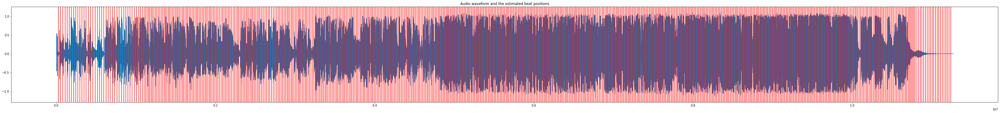

In [24]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (60, 6) # set plot sizes to something larger than default

plot(audio)
for beat in beats:
    plt.axvline(x=beat*44100, color='red')

plt.title("Audio waveform and the estimated beat positions")

Overall BPM (estimated before): 161.7
First histogram peak: 161.0 bpm
Second histogram peak: 148.0 bpm


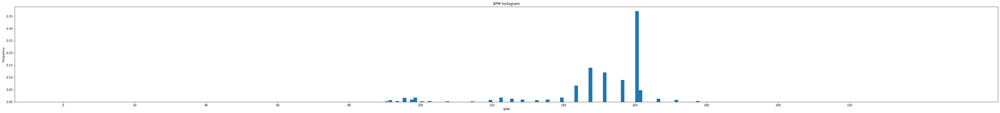

In [27]:
peak1_bpm, peak1_weight, peak1_spread, peak2_bpm, peak2_weight, peak2_spread, histogram = BpmHistogramDescriptors()(beats_intervals)

print("Overall BPM (estimated before): %0.1f" % bpm)
print("First histogram peak: %0.1f bpm" % peak1_bpm)
print("Second histogram peak: %0.1f bpm" % peak2_bpm)

fig, ax = plt.subplots()
ax.bar(range(len(histogram)), histogram, width=1)
ax.set_xlabel('BPM')
ax.set_ylabel('Frequency')
plt.title("BPM histogram")
ax.set_xticks([20 * x + 0.5 for x in range(int(len(histogram) / 20))])
ax.set_xticklabels([str(20 * x) for x in range(int(len(histogram) / 20))])
plt.show()

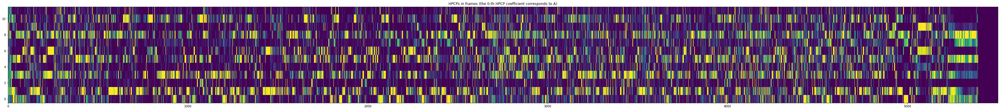

Estimated key and scale: Bb major


In [29]:
import essentia.streaming as ess
# Initialize algorithms we will use
loader = ess.MonoLoader(filename='tardedemais.webm')
framecutter = ess.FrameCutter(frameSize=4096, hopSize=2048, silentFrames='noise')
windowing = ess.Windowing(type='blackmanharris62')
spectrum = ess.Spectrum()
spectralpeaks = ess.SpectralPeaks(orderBy='magnitude',
                                  magnitudeThreshold=0.00001,
                                  minFrequency=20,
                                  maxFrequency=3500,
                                  maxPeaks=60)

# Use default HPCP parameters for plots, however we will need higher resolution
# and custom parameters for better Key estimation

hpcp = ess.HPCP()
hpcp_key = ess.HPCP(size=36, # we will need higher resolution for Key estimation
                    referenceFrequency=440, # assume tuning frequency is 44100.
                    bandPreset=False,
                    minFrequency=20,
                    maxFrequency=3500,
                    weightType='cosine',
                    nonLinear=False,
                    windowSize=1.)

key = ess.Key(profileType='edma', # Use profile for electronic music
              numHarmonics=4,
              pcpSize=36,
              slope=0.6,
              usePolyphony=True,
              useThreeChords=True)

# Use pool to store data
pool = essentia.Pool()

# Connect streaming algorithms
loader.audio >> framecutter.signal
framecutter.frame >> windowing.frame >> spectrum.frame
spectrum.spectrum >> spectralpeaks.spectrum
spectralpeaks.magnitudes >> hpcp.magnitudes
spectralpeaks.frequencies >> hpcp.frequencies
spectralpeaks.magnitudes >> hpcp_key.magnitudes
spectralpeaks.frequencies >> hpcp_key.frequencies
hpcp_key.hpcp >> key.pcp
hpcp.hpcp >> (pool, 'tonal.hpcp')
key.key >> (pool, 'tonal.key_key')
key.scale >> (pool, 'tonal.key_scale')
key.strength >> (pool, 'tonal.key_strength')

# Run streaming network
essentia.run(loader)

# Plot HPCP
imshow(pool['tonal.hpcp'].T, aspect='auto', origin='lower', interpolation='none')
plt.title("HPCPs in frames (the 0-th HPCP coefficient corresponds to A)")
show()

print("Estimated key and scale:", pool['tonal.key_key'] + " " + pool['tonal.key_scale'])

In [31]:

ChordsDetection(loader) 

TypeError: __init__() takes 1 positional argument but 2 were given